In [1]:
#Import the libraries
import pandas as pd
import numpy as np

import requests
import matplotlib.pyplot as plt
import yfinance as yf
import datetime
import math
from datetime import timedelta 
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns
from pypfopt import plotting
import cvxpy as cp
#from joblib import Parallel, delayed
#Import our homebrew functions
import DatabaseMainFnc as dmf

pd.options.mode.chained_assignment = None #silences setting with a copy warning
pd.set_option('display.max_columns', 38)
plt.rcParams['figure.figsize'] = [15, 10]


### Load the data

In [3]:
%%time
#Load generated portfolio performance data
df_EF_Nasdaq=pd.read_csv('Portfolio data/Nasdaq_EF_data.csv')
df_EF_NYSE=pd.read_csv('Portfolio data/NYSE_EF_data.csv')

df_EF_Nasdaq.drop(columns='Unnamed: 0', inplace=True)
df_EF_NYSE.drop(columns='Unnamed: 0', inplace=True)
print(df_EF_Nasdaq.max_returns.max())
print(df_EF_NYSE.max_returns.max())
df_EF_NYSE[df_EF_NYSE.max_returns>10]

inf
inf
Wall time: 620 ms


,Start_Date,End_date,Expected_returns,volatility,sharpe_ratio,max_returns,min_returns,actual_returns,mean_returns,objective_summary,starting_asset
3467,2017-01-01,2018-02-01,1.259620,0.141944,8.733136,inf,-1.0,0.358435,inf,SHARPE,0
6541,2012-02-01,2015-12-01,0.968418,0.206914,4.583631,inf,-1.0,inf,inf,SHARPE,0
6542,2012-03-01,2015-12-01,0.948200,0.203952,4.551074,inf,-1.0,inf,inf,SHARPE,0
6543,2012-04-01,2015-12-01,0.962186,0.202906,4.643453,inf,-1.0,inf,inf,SHARPE,0
6544,2012-05-01,2015-12-01,0.965210,0.203976,4.633917,inf,-1.0,inf,inf,SHARPE,0
...,...,...,...,...,...,...,...,...,...,...,...
130292,2009-02-01,2010-07-01,0.455569,0.147953,2.943962,inf,-1.0,inf,inf,SHARPE,500
130293,2009-03-01,2010-07-01,0.722161,0.158423,4.432177,inf,-1.0,inf,inf,SHARPE,500
130294,2009-04-01,2010-07-01,0.626885,0.126899,4.782410,inf,-1.0,inf,inf,SHARPE,500
130295,2009-05-01,2010-07-01,0.460594,0.113106,3.895410,inf,-1.0,inf,inf,SHARPE,500


### Engineer threshold flags

In [61]:
for df in [df_EF_Nasdaq,df_EF_NYSE]:
    df['End_date']=pd.to_datetime(df['End_date'])
    df['Start_Date']=pd.to_datetime(df['Start_Date'])
    df['max_5']=(df['max_returns']>0.05).astype(int)
    df['max_10']=(df['max_returns']>0.10).astype(int)
    df['max_15']=(df['max_returns']>0.15).astype(int)
    df['max_20']=(df['max_returns']>0.20).astype(int)
    df['max_25']=(df['max_returns']>0.25).astype(int)
    df['max_30']=(df['max_returns']>0.30).astype(int)
    df['max_40']=(df['max_returns']>0.40).astype(int)
    df['max_50']=(df['max_returns']>0.50).astype(int)
    df['max_expected']=(df['max_returns']>df['Expected_returns']).astype(int)
    df['max_expected_diff']=df['max_returns']-df['Expected_returns']
    df['input_months']=((df.End_date - df.Start_Date)/np.timedelta64(1, 'M')).astype(int)
df_EF_Nasdaq.head()

,Start_Date,End_date,Expected_returns,volatility,sharpe_ratio,max_returns,min_returns,actual_returns,mean_returns,objective_summary,starting_asset,max_5,max_10,max_15,max_20,max_25,max_30,max_40,max_50,max_expected,max_expected_diff,input_years,input_months
0,2006-01-01,2020-01-01,0.340201,0.163608,1.957126,0.032889,-0.385575,-0.044316,-0.127836,SHARPE,0,0,0,0,0,0,0,0,0,0,-0.307312,5113 days,167
1,2006-02-01,2020-01-01,0.338718,0.162002,1.967371,0.035543,-0.375235,-0.024118,-0.116698,SHARPE,0,0,0,0,0,0,0,0,0,0,-0.303175,5082 days,166
2,2006-03-01,2020-01-01,0.331328,0.158134,1.968760,0.033160,-0.371608,-0.025938,-0.103632,SHARPE,0,0,0,0,0,0,0,0,0,0,-0.298168,5054 days,166
3,2006-04-01,2020-01-01,0.329074,0.156841,1.970620,0.032209,-0.368424,-0.027640,-0.105982,SHARPE,0,0,0,0,0,0,0,0,0,0,-0.296865,5023 days,165
4,2006-05-01,2020-01-01,0.333514,0.159781,1.962152,0.036577,-0.373719,-0.024984,-0.113825,SHARPE,0,0,0,0,0,0,0,0,0,0,-0.296937,4993 days,164


0         False
1         False
2         False
3         False
4         False
          ...  
130016    False
130017    False
130018    False
130019    False
130020    False
Name: mean_returns, Length: 130021, dtype: bool

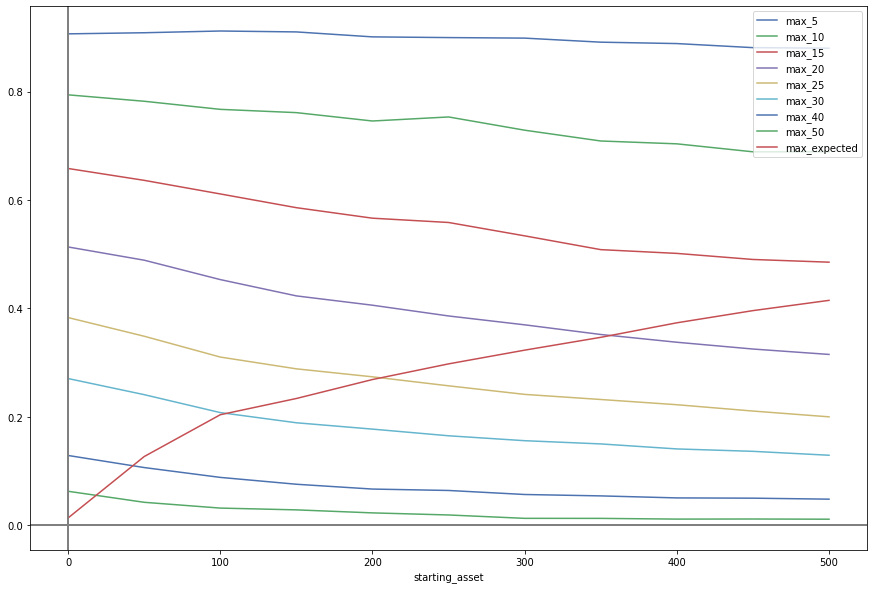

In [64]:
#show % of potfolios that made more than 5%
for perc in ['max_5', 'max_10', 'max_15', 'max_20', 'max_25', 'max_30', 'max_40', 'max_50','max_expected']:
    (df_EF_Nasdaq.groupby(['starting_asset'])[perc].sum()/df_EF_Nasdaq.groupby(['starting_asset'])[perc].count()).plot(legend=True)
    plt.axhline(0,color='gray') # x = 0
    plt.axvline(0,color='gray') # y = 0
    ax1.set_ylim([0, 1])   


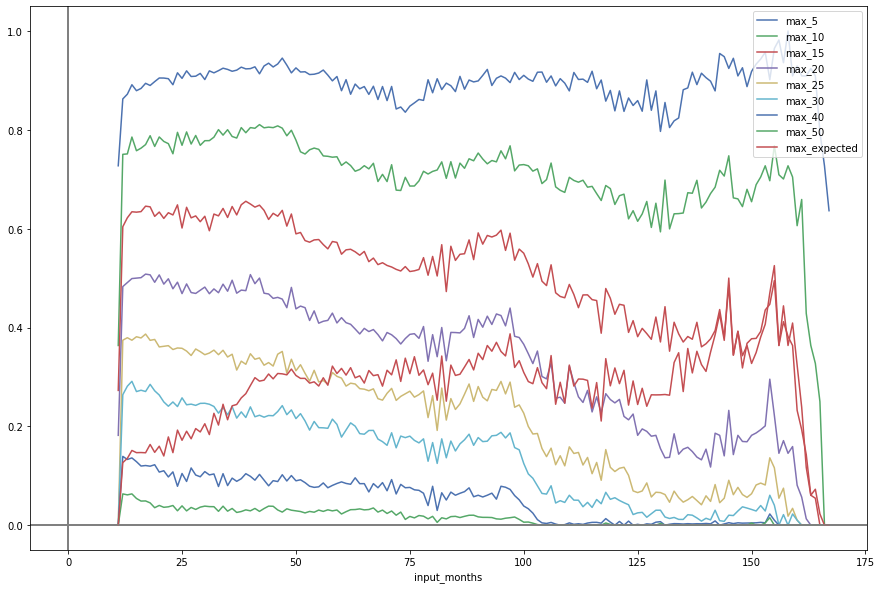

In [65]:
#show % of potfolios that made more than 5%
for perc in ['max_5', 'max_10', 'max_15', 'max_20', 'max_25', 'max_30', 'max_40', 'max_50','max_expected']:
    (df_EF_Nasdaq.groupby(['input_months'])[perc].sum()/df_EF_Nasdaq.groupby(['input_months'])[perc].count()).plot(legend=True)
    plt.axhline(0,color='gray') # x = 0
    plt.axvline(0,color='gray') # y = 0
    ax1.set_ylim([0, 1])   

input_months
11     0.095691
12          inf
13          inf
14          inf
15          inf
         ...   
163    0.092440
164    0.087023
165    0.076732
166    0.060180
167    0.052813
Name: max_returns, Length: 157, dtype: float64

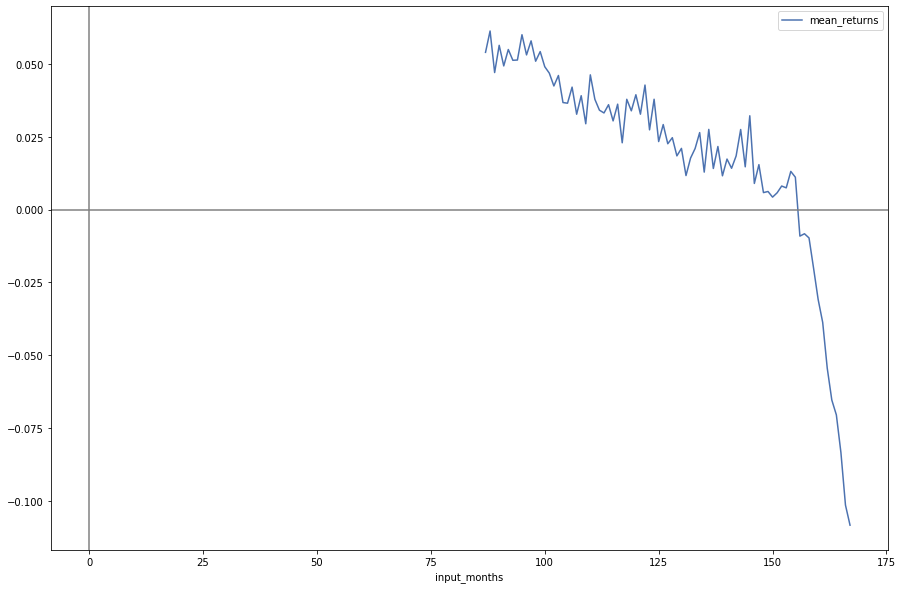

In [68]:

(df_EF_Nasdaq.groupby(['input_months'])['mean_returns'].mean()).plot(legend=True)
plt.axhline(0,color='gray') # x = 0
plt.axvline(0,color='gray') # y = 0
df_EF_Nasdaq.groupby(['input_months'])['max_returns'].mean()


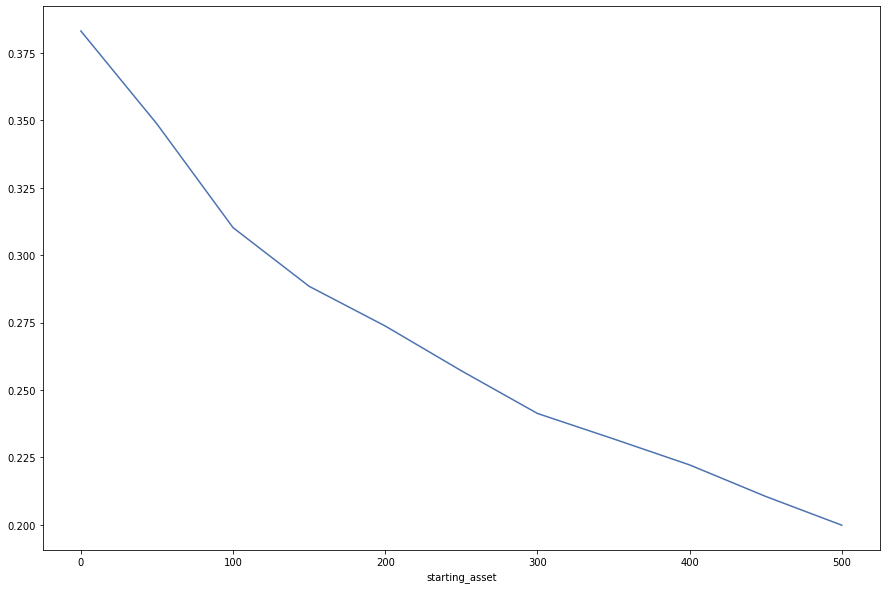

In [29]:
#show % of potfolios that made more than 5%
(df_EF_Nasdaq.groupby(['starting_asset'])['max_25'].sum()/df_EF_Nasdaq.groupby(['starting_asset'])['max_25'].count()).plot()


(-1, 6)

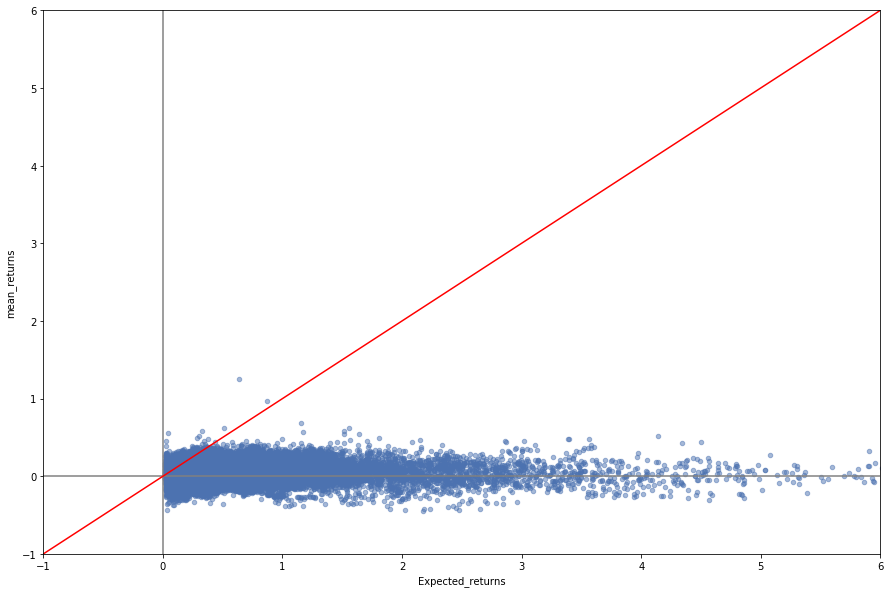

In [23]:
# Plot expected vs actual scatter
import matplotlib.lines as mlines
ax1 = df_EF_Nasdaq.plot.scatter(x='Expected_returns', y='mean_returns',alpha=0.5)

#set the x=y line
line = mlines.Line2D([0, 1], [0, 1], color='red')

#draw axis lines
plt.axhline(0,color='gray') # x = 0
plt.axvline(0,color='gray') # y = 0
transform = ax1.transAxes
line.set_transform(transform)
ax1.add_line(line)
ax1.set_xlim([-1, 6])
ax1.set_ylim([-1, 6])

(-1, 6)

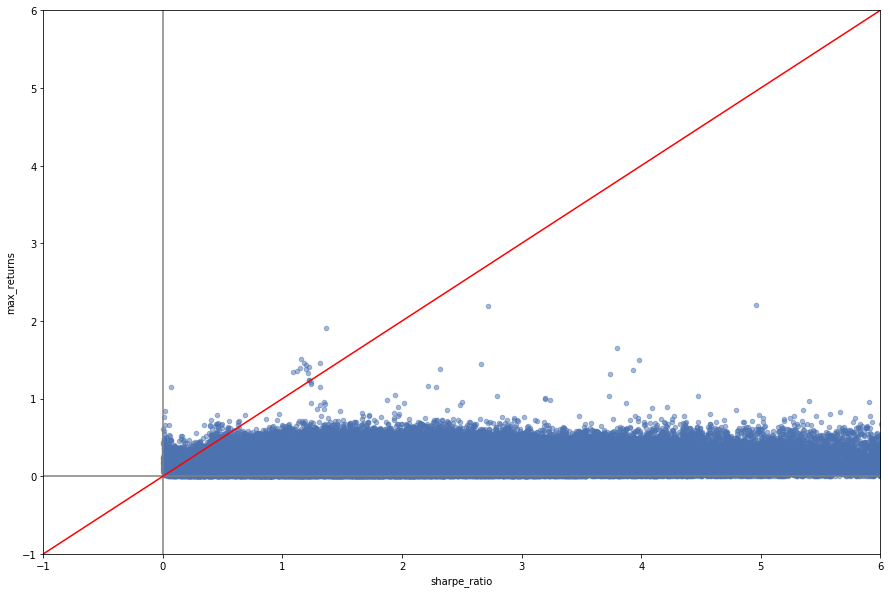

In [22]:
# Plot expected vs actual scatter
import matplotlib.lines as mlines
ax1 = df_EF_Nasdaq[df_EF_Nasdaq].plot.scatter(x='sharpe_ratio', y='max_returns',alpha=0.5)

#set the x=y line
line = mlines.Line2D([0, 1], [0, 1], color='red')

#draw axis lines
plt.axhline(0,color='gray') # x = 0
plt.axvline(0,color='gray') # y = 0
transform = ax1.transAxes
line.set_transform(transform)
ax1.add_line(line)
ax1.set_xlim([-1, 6])
ax1.set_ylim([-1, 6])